Animation size has reached 20981772 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


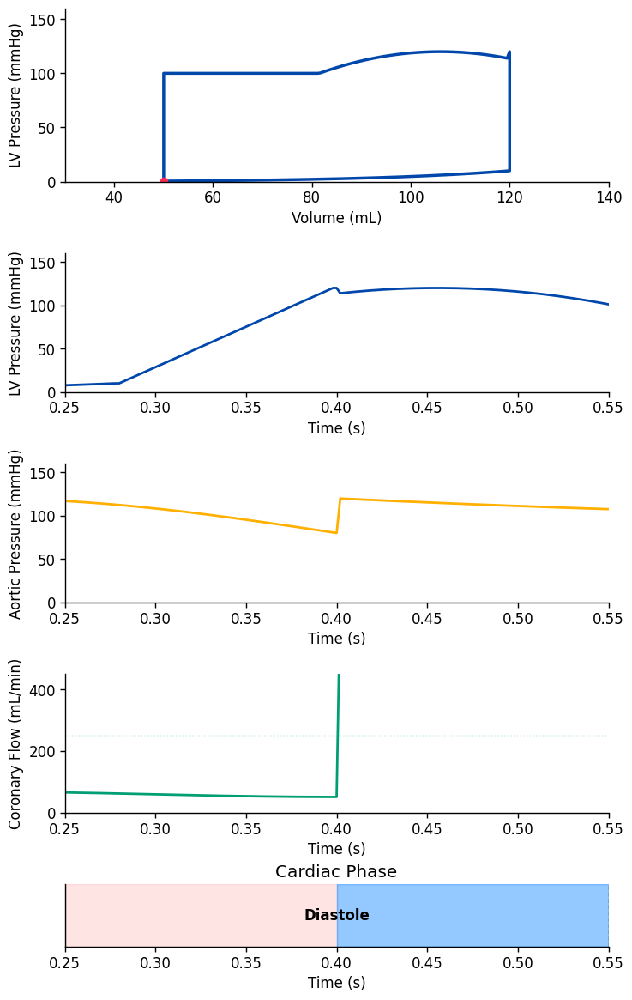

In [4]:
# Sleek multi-panel cardiac animation
# Panels: PV loop + LV pressure + Aortic pressure + Coronary flow + Systole/Diastole
# Narrow x-axis on time plots (≈ 0.25–0.55 s), ready for Jupyter/Colab
# Embed limit raised to 100 MB to avoid dropped frames when using to_jshtml()

# Install required packages in Jupyter
!pip install numpy matplotlib

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib import patches
from IPython.display import HTML
import matplotlib as mpl

# --- Raise the inline animation embed limit (Option 1) ---
mpl.rcParams['animation.embed_limit'] = 100  # MB (default = 20)

# -----------------------------
# Core cardiac parameters
# -----------------------------
HR = 75.0
T  = 60.0 / HR                 # ~0.8 s per beat
EDV, ESV = 120.0, 50.0         # mL
SV = EDV - ESV
P_peak_sys, P_diast_ao, LVEDP_target = 120.0, 80.0, 10.0

# Phase sample counts (shape/timing of the beat)
N_fill, N_isoC, N_eject, N_isoR = 140, 60, 140, 60
N_total = N_fill + N_isoC + N_eject + N_isoR
N_frames = N_total + 1                     # +1 so PV trace closes neatly
interval_ms = int(1000 * T / (N_frames-1))

# -----------------------------
# LV diastolic P–V relation (exponential)
# -----------------------------
V0, k = 30.0, 0.035
A = LVEDP_target / (np.exp(k*(EDV - V0)) - 1.0)
def P_ed(V): return A * (np.exp(k*(V - V0)) - 1.0)

# -----------------------------
# Build PV loop (time-ordered)
# -----------------------------
# 1) Filling (ESV -> EDV)
V_fill = np.linspace(ESV, EDV, N_fill, endpoint=True)
P_fill = P_ed(V_fill)

# 2) Isovolumic contraction at EDV
P_isoC = np.linspace(P_ed(EDV), P_peak_sys, N_isoC, endpoint=True)
V_isoC = np.full_like(P_isoC, EDV)

# 3) Ejection (EDV -> ESV): early peak then decline
x_ej = np.linspace(0, 1, N_eject, endpoint=True)
V_ej = EDV - SV * x_ej
P_end_eject = 100.0
peak_pos = 0.20
shape = np.clip(1 - ((x_ej - peak_pos)/0.35)**2, 0, 1)
P_ej = (P_peak_sys - P_end_eject) * shape + P_end_eject
P_ej[0] = P_isoC[-1]  # continuity

# 4) Isovolumic relaxation (ESV -> diastolic curve at ESV)
P_isoR = np.linspace(P_ej[-1], P_ed(ESV), N_isoR, endpoint=True)
V_isoR = np.full_like(P_isoR, ESV)

# Concatenate PV path
V_path    = np.concatenate([V_fill, V_isoC, V_ej, V_isoR])     # len N_total
P_lv_path = np.concatenate([P_fill, P_isoC, P_ej, P_isoR])
assert len(V_path) == len(P_lv_path) == N_total

# Closed loop for cumulative drawing
V_closed = np.concatenate([V_path, V_path[:1]])    # len N_total+1
P_closed = np.concatenate([P_lv_path, P_lv_path[:1]])

# Master time base & index mapping
t_frames = np.linspace(0.0, T, N_frames, endpoint=True)                 # 0..T
j_idx    = np.floor((t_frames / T) * N_total).astype(int) % N_total     # 0..N_total-1

# Systole duration (isoC + ejection) used by all time-based signals
Ts_total = T * (N_isoC + N_eject) / N_total
is_systole_frame = t_frames <= Ts_total

# -----------------------------
# Aortic pressure (from master time)
# -----------------------------
P_ao_frames = np.empty_like(t_frames)
# Systolic half-sine up to ~120 mmHg
s_mask = is_systole_frame
if np.any(s_mask):
    P_ao_frames[s_mask] = P_diast_ao + 40.0 * np.sin(np.pi * t_frames[s_mask] / Ts_total)
# Diastolic exponential decay
if np.any(~s_mask):
    td = t_frames[~s_mask] - Ts_total
    P_es = P_diast_ao + 40.0
    tau_diast_ao = 0.40
    P_ao_frames[~s_mask] = P_diast_ao + (P_es - P_diast_ao) * np.exp(-td / tau_diast_ao)

# -----------------------------
# LV pressure vs time (aligned with PV loop)
# -----------------------------
P_lv_frames = P_lv_path[j_idx]            # instantaneous LV P at each frame
t_samples   = np.linspace(0, T, N_total, endpoint=False)  # static curve support

# -----------------------------
# Coronary flow (mL/min) from master time
# -----------------------------
C_mean_target = 250.0
C_raw = np.zeros_like(t_frames)
C_sys_min, C_sys_osc = 30.0, 10.0
if np.any(s_mask):
    C_raw[s_mask] = C_sys_min + C_sys_osc * np.sin(np.pi * t_frames[s_mask] / Ts_total)**2
C_peak, C_floor, tau_coro = 420.0, 100.0, 0.25
if np.any(~s_mask):
    td = t_frames[~s_mask] - Ts_total
    C_raw[~s_mask] = C_floor + (C_peak - C_floor) * np.exp(-td / tau_coro)
scale = C_mean_target / max(np.mean(C_raw), 1e-9)
C_cor_frames = C_raw * scale

# -----------------------------
# Figure setup (sleek, minimal)
# -----------------------------
plt.style.use("default")
plt.rcParams.update({
    "axes.edgecolor": "black",
    "axes.linewidth": 1.0,
    "font.size": 12,
    "xtick.direction": "out",
    "ytick.direction": "out",
})

fig = plt.figure(figsize=(8.2, 14.2))
gs = fig.add_gridspec(5, 1, height_ratios=[1.25, 1.0, 1.0, 1.0, 0.45], hspace=0.55)

# Helper to style axes and set narrow x-range on time plots
def style_axes(ax, xlabel="", ylabel="", ylim=None, narrow=False):
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    if ylim is not None:
        ax.set_ylim(*ylim)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.tick_params(length=4, width=1)
    if narrow:
        ax.set_xlim(0.25, 0.55)     # <<< tighter, sleek window (systole → early diastole)
    else:
        ax.set_xlim(0, T)

# --- PV loop ---
ax_pv = fig.add_subplot(gs[0, 0])
style_axes(ax_pv, "Volume (mL)", "LV Pressure (mmHg)", (0, 160), narrow=False)
ax_pv.set_xlim(30, 140)
# Context outline
ax_pv.plot(V_closed, P_closed, color="#C8CCD1", lw=1.2)
# Animated artists
pv_trace, = ax_pv.plot([], [], color="#0047AB", lw=2.5)          # LV blue
pv_dot,   = ax_pv.plot([], [], "o", color="#FF2D55", ms=6)

# --- LV pressure vs time (narrow) ---
ax_lv = fig.add_subplot(gs[1, 0])
style_axes(ax_lv, "Time (s)", "LV Pressure (mmHg)", (0, 160), narrow=True)
lv_line, = ax_lv.plot(t_samples, P_lv_path, color="#0047AB", lw=2.0)
lv_dot,  = ax_lv.plot([], [], "o", color="#0047AB", ms=6)
lv_cursor = ax_lv.axvline(0, color="black", lw=1, ls="--", alpha=0.7)

# --- Aortic pressure vs time (narrow) ---
ax_ao = fig.add_subplot(gs[2, 0])
style_axes(ax_ao, "Time (s)", "Aortic Pressure (mmHg)", (0, 160), narrow=True)
ao_line, = ax_ao.plot(t_frames, P_ao_frames, color="#FFB000", lw=2.0)  # Ao gold
ao_dot,  = ax_ao.plot([], [], "o", color="#FFB000", ms=6)
ao_cursor = ax_ao.axvline(0, color="black", lw=1, ls="--", alpha=0.7)

# --- Coronary flow vs time (narrow) ---
ax_cf = fig.add_subplot(gs[3, 0])
style_axes(ax_cf, "Time (s)", "Coronary Flow (mL/min)", (0, 450), narrow=True)
cf_line, = ax_cf.plot(t_frames, C_cor_frames, color="#009E73", lw=2.0)  # green
cf_dot,  = ax_cf.plot([], [], "o", color="#009E73", ms=6)
cf_cursor = ax_cf.axvline(0, color="black", lw=1, ls="--", alpha=0.7)
ax_cf.axhline(250, color="#009E73", lw=1.0, ls=":", alpha=0.7)

# --- Systole/Diastole phase (narrow) ---
ax_phase = fig.add_subplot(gs[4, 0])
style_axes(ax_phase, "Time (s)", "", (0, 1), narrow=True)
ax_phase.set_yticks([])
ax_phase.set_title("Cardiac Phase")
# static spans
ax_phase.axvspan(0.25, min(Ts_total, 0.55), color="#FF6B6B", alpha=0.18)   # systole within window
ax_phase.axvspan(max(0.25, Ts_total), 0.55, color="#4DA6FF", alpha=0.18)   # diastole within window
# animated fills
rect_sys = patches.Rectangle((0.25, 0), 0.0, 1.0, color="#FF3B30", alpha=0.35)
rect_dia = patches.Rectangle((max(0.25, Ts_total), 0), 0.0, 1.0, color="#0A84FF", alpha=0.35)
ax_phase.add_patch(rect_sys); ax_phase.add_patch(rect_dia)
phase_cursor = ax_phase.axvline(0.25, color="black", lw=1, ls="--", alpha=0.8)
phase_text = ax_phase.text(0.5, 0.5, "", ha="center", va="center",
                           fontsize=12, weight="bold", transform=ax_phase.transAxes)

# -----------------------------
# Animation functions
# -----------------------------
def init():
    for artist in (pv_trace, pv_dot, lv_dot, ao_dot, cf_dot):
        artist.set_data([], [])
    return pv_trace, pv_dot, lv_dot, ao_dot, cf_dot

def update(frame):
    tt = t_frames[frame]   # master time 0..T

    # PV loop (full closed, cumulative per beat)
    pv_trace.set_data(V_closed[:frame+1], P_closed[:frame+1])
    pv_dot.set_data([V_closed[frame]], [P_closed[frame]])

    # LV pressure (dot + cursor)
    lv_dot.set_data([tt], [P_lv_frames[frame]])
    lv_cursor.set_xdata([tt, tt])

    # Aortic pressure (dot + cursor)
    ao_dot.set_data([tt], [P_ao_frames[frame]])
    ao_cursor.set_xdata([tt, tt])

    # Coronary flow (dot + cursor)
    cf_dot.set_data([tt], [C_cor_frames[frame]])
    cf_cursor.set_xdata([tt, tt])

    # Phase bars (clamped to the narrow window 0.25–0.55 s)
    left, right = 0.25, 0.55
    clamped_t = min(max(tt, left), right)
    phase_cursor.set_xdata([clamped_t, clamped_t])

    if tt <= Ts_total:
        rect_sys.set_x(left)
        rect_sys.set_width(max(0.0, clamped_t - left))
        rect_dia.set_width(0.0)
        phase_text.set_text("Systole")
    else:
        rect_sys.set_width(0.0)
        rect_dia.set_x(max(left, Ts_total))
        rect_dia.set_width(max(0.0, clamped_t - max(left, Ts_total)))
        phase_text.set_text("Diastole")

    return (pv_trace, pv_dot, lv_dot, ao_dot, cf_dot,
            lv_cursor, ao_cursor, cf_cursor, rect_sys, rect_dia, phase_cursor, phase_text)

anim = animation.FuncAnimation(
    fig, update, init_func=init,
    frames=N_frames, interval=interval_ms, blit=False, repeat=True
)

HTML(anim.to_jshtml())


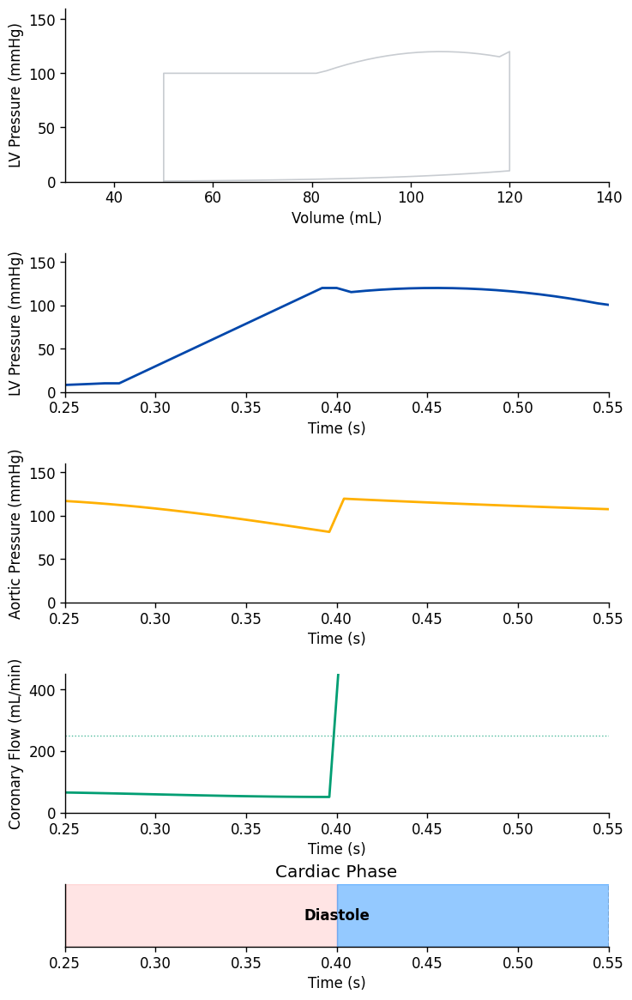

In [8]:
# Sleek multi-panel cardiac animation
# Panels: PV loop + LV pressure + Aortic pressure + Coronary flow + Systole/Diastole
# Narrow x-axis on time plots (≈ 0.25–0.55 s), ready for Jupyter/Colab
# Embed limit raised to 100 MB to avoid dropped frames when using to_jshtml()

# --- Install required packages if missing ---
try:
    import numpy as np
    import matplotlib.pyplot as plt
    import matplotlib.animation as animation
    from matplotlib import patches
    from IPython.display import HTML
    import matplotlib as mpl
except ImportError:
    import sys
    !{sys.executable} -m pip install numpy matplotlib
    import numpy as np
    import matplotlib.pyplot as plt
    import matplotlib.animation as animation
    from matplotlib import patches
    from IPython.display import HTML
    import matplotlib as mpl

# --- Raise the inline animation embed limit (Option 1) ---
mpl.rcParams['animation.embed_limit'] = 20  # MB (default = 20)

# -----------------------------
# Core cardiac parameters
# -----------------------------
HR = 75.0
T  = 60.0 / HR                 # ~0.8 s per beat
EDV, ESV = 120.0, 50.0         # mL
SV = EDV - ESV
P_peak_sys, P_diast_ao, LVEDP_target = 120.0, 80.0, 10.0

# Phase sample counts (shape/timing of the beat)
# Scaled down to reduce data points for a smaller animation file
N_fill, N_isoC, N_eject, N_isoR = 35, 15, 35, 15
N_total = N_fill + N_isoC + N_eject + N_isoR
N_frames = 100                     # Target 100 frames for the animation
interval_ms = int(1000 * T / (N_frames-1))

# -----------------------------
# LV diastolic P–V relation (exponential)
# -----------------------------
V0, k = 30.0, 0.035
A = LVEDP_target / (np.exp(k*(EDV - V0)) - 1.0)
def P_ed(V): return A * (np.exp(k*(V - V0)) - 1.0)

# -----------------------------
# Build PV loop (time-ordered)
# -----------------------------
# 1) Filling (ESV -> EDV)
V_fill = np.linspace(ESV, EDV, N_fill, endpoint=True)
P_fill = P_ed(V_fill)

# 2) Isovolumic contraction at EDV
P_isoC = np.linspace(P_ed(EDV), P_peak_sys, N_isoC, endpoint=True)
V_isoC = np.full_like(P_isoC, EDV)

# 3) Ejection (EDV -> ESV): early peak then decline
x_ej = np.linspace(0, 1, N_eject, endpoint=True)
V_ej = EDV - SV * x_ej
P_end_eject = 100.0
peak_pos = 0.20
shape = np.clip(1 - ((x_ej - peak_pos)/0.35)**2, 0, 1)
P_ej = (P_peak_sys - P_end_eject) * shape + P_end_eject
P_ej[0] = P_isoC[-1]  # continuity

# 4) Isovolumic relaxation (ESV -> diastolic curve at ESV)
P_isoR = np.linspace(P_ej[-1], P_ed(ESV), N_isoR, endpoint=True)
V_isoR = np.full_like(P_isoR, ESV)

# Concatenate PV path
V_path    = np.concatenate([V_fill, V_isoC, V_ej, V_isoR])     # len N_total
P_lv_path = np.concatenate([P_fill, P_isoC, P_ej, P_isoR])
assert len(V_path) == len(P_lv_path) == N_total

# Closed loop for cumulative drawing
V_closed = np.concatenate([V_path, V_path[:1]])    # len N_total+1
P_closed = np.concatenate([P_lv_path, P_lv_path[:1]])

# Master time base & index mapping
t_frames = np.linspace(0.0, T, N_frames, endpoint=True)                 # 0..T
j_idx    = np.floor((t_frames / T) * (len(V_path)-1)).astype(int) % (len(V_path)-1)     # 0..N_total-1

# Systole duration (isoC + ejection) used by all time-based signals
Ts_total = T * (N_isoC + N_eject) / N_total
is_systole_frame = t_frames <= Ts_total

# -----------------------------
# Aortic pressure (from master time)
# -----------------------------
P_ao_frames = np.empty_like(t_frames)
# Systolic half-sine up to ~120 mmHg
s_mask = is_systole_frame
if np.any(s_mask):
    P_ao_frames[s_mask] = P_diast_ao + 40.0 * np.sin(np.pi * t_frames[s_mask] / Ts_total)
# Diastolic exponential decay
if np.any(~s_mask):
    td = t_frames[~s_mask] - Ts_total
    P_es = P_diast_ao + 40.0
    tau_diast_ao = 0.40
    P_ao_frames[~s_mask] = P_diast_ao + (P_es - P_diast_ao) * np.exp(-td / tau_diast_ao)

# -----------------------------
# LV pressure vs time (aligned with PV loop)
# -----------------------------
P_lv_frames = P_lv_path[j_idx]            # instantaneous LV P at each frame
t_samples   = np.linspace(0, T, N_total, endpoint=False)  # static curve support

# -----------------------------
# Coronary flow (mL/min) from master time
# -----------------------------
C_mean_target = 250.0
C_raw = np.zeros_like(t_frames)
C_sys_min, C_sys_osc = 30.0, 10.0
if np.any(s_mask):
    C_raw[s_mask] = C_sys_min + C_sys_osc * np.sin(np.pi * t_frames[s_mask] / Ts_total)**2
C_peak, C_floor, tau_coro = 420.0, 100.0, 0.25
if np.any(~s_mask):
    td = t_frames[~s_mask] - Ts_total
    C_raw[~s_mask] = C_floor + (C_peak - C_floor) * np.exp(-td / tau_coro)
scale = C_mean_target / max(np.mean(C_raw), 1e-9)
C_cor_frames = C_raw * scale

# -----------------------------
# Figure setup (sleek, minimal)
# -----------------------------
plt.style.use("default")
plt.rcParams.update({
    "axes.edgecolor": "black",
    "axes.linewidth": 1.0,
    "font.size": 12,
    "xtick.direction": "out",
    "ytick.direction": "out",
})

fig = plt.figure(figsize=(8.2, 14.2))
gs = fig.add_gridspec(5, 1, height_ratios=[1.25, 1.0, 1.0, 1.0, 0.45], hspace=0.55)

# Helper to style axes and set narrow x-range on time plots
def style_axes(ax, xlabel="", ylabel="", ylim=None, narrow=False):
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    if ylim is not None:
        ax.set_ylim(*ylim)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.tick_params(length=4, width=1)
    if narrow:
        ax.set_xlim(0.25, 0.55)     # <<< tighter, sleek window (systole → early diastole)
    else:
        ax.set_xlim(0, T)

# --- PV loop ---
ax_pv = fig.add_subplot(gs[0, 0])
style_axes(ax_pv, "Volume (mL)", "LV Pressure (mmHg)", (0, 160), narrow=False)
ax_pv.set_xlim(30, 140)
# Context outline
ax_pv.plot(V_closed, P_closed, color="#C8CCD1", lw=1.2)
# Animated artists
pv_trace, = ax_pv.plot([], [], color="#0047AB", lw=2.5)          # LV blue
pv_dot,   = ax_pv.plot([], [], "o", color="#FF2D55", ms=6)

# --- LV pressure vs time (narrow) ---
ax_lv = fig.add_subplot(gs[1, 0])
style_axes(ax_lv, "Time (s)", "LV Pressure (mmHg)", (0, 160), narrow=True)
lv_line, = ax_lv.plot(t_samples, P_lv_path, color="#0047AB", lw=2.0)
lv_dot,  = ax_lv.plot([], [], "o", color="#0047AB", ms=6)
lv_cursor = ax_lv.axvline(0, color="black", lw=1, ls="--", alpha=0.7)

# --- Aortic pressure vs time (narrow) ---
ax_ao = fig.add_subplot(gs[2, 0])
style_axes(ax_ao, "Time (s)", "Aortic Pressure (mmHg)", (0, 160), narrow=True)
ao_line, = ax_ao.plot(t_frames, P_ao_frames, color="#FFB000", lw=2.0)  # Ao gold
ao_dot,  = ax_ao.plot([], [], "o", color="#FFB000", ms=6)
ao_cursor = ax_ao.axvline(0, color="black", lw=1, ls="--", alpha=0.7)

# --- Coronary flow vs time (narrow) ---
ax_cf = fig.add_subplot(gs[3, 0])
style_axes(ax_cf, "Time (s)", "Coronary Flow (mL/min)", (0, 450), narrow=True)
cf_line, = ax_cf.plot(t_frames, C_cor_frames, color="#009E73", lw=2.0)  # green
cf_dot,  = ax_cf.plot([], [], "o", color="#009E73", ms=6)
cf_cursor = ax_cf.axvline(0, color="black", lw=1, ls="--", alpha=0.7)
ax_cf.axhline(250, color="#009E73", lw=1.0, ls=":", alpha=0.7)

# --- Systole/Diastole phase (narrow) ---
ax_phase = fig.add_subplot(gs[4, 0])
style_axes(ax_phase, "Time (s)", "", (0, 1), narrow=True)
ax_phase.set_yticks([])
ax_phase.set_title("Cardiac Phase")
# static spans
ax_phase.axvspan(0.25, min(Ts_total, 0.55), color="#FF6B6B", alpha=0.18)   # systole within window
ax_phase.axvspan(max(0.25, Ts_total), 0.55, color="#4DA6FF", alpha=0.18)   # diastole within window
# animated fills
rect_sys = patches.Rectangle((0.25, 0), 0.0, 1.0, color="#FF3B30", alpha=0.35)
rect_dia = patches.Rectangle((max(0.25, Ts_total), 0), 0.0, 1.0, color="#0A84FF", alpha=0.35)
ax_phase.add_patch(rect_sys); ax_phase.add_patch(rect_dia)
phase_cursor = ax_phase.axvline(0.25, color="black", lw=1, ls="--", alpha=0.8)
phase_text = ax_phase.text(0.5, 0.5, "", ha="center", va="center",
                           fontsize=12, weight="bold", transform=ax_phase.transAxes)

# -----------------------------
# Animation functions
# -----------------------------
def init():
    for artist in (pv_trace, pv_dot, lv_dot, ao_dot, cf_dot):
        artist.set_data([], [])
    return pv_trace, pv_dot, lv_dot, ao_dot, cf_dot

def update(frame):
    tt = t_frames[frame]   # master time 0..T
    
    # Map frame index to PV path index
    path_idx = j_idx[frame]

    # PV loop (full closed, cumulative per beat)
    pv_trace.set_data(V_closed[:path_idx+1], P_closed[:path_idx+1])
    pv_dot.set_data([V_closed[path_idx]], [P_closed[path_idx]])

    # LV pressure (dot + cursor)
    lv_dot.set_data([tt], [P_lv_frames[frame]])
    lv_cursor.set_xdata([tt, tt])

    # Aortic pressure (dot + cursor)
    ao_dot.set_data([tt], [P_ao_frames[frame]])
    ao_cursor.set_xdata([tt, tt])

    # Coronary flow (dot + cursor)
    cf_dot.set_data([tt], [C_cor_frames[frame]])
    cf_cursor.set_xdata([tt, tt])

    # Phase bars (clamped to the narrow window 0.25–0.55 s)
    left, right = 0.25, 0.55
    clamped_t = min(max(tt, left), right)
    phase_cursor.set_xdata([clamped_t, clamped_t])

    if tt <= Ts_total:
        rect_sys.set_x(left)
        rect_sys.set_width(max(0.0, clamped_t - left))
        rect_dia.set_width(0.0)
        phase_text.set_text("Systole")
    else:
        rect_sys.set_width(0.0)
        rect_dia.set_x(max(left, Ts_total))
        rect_dia.set_width(max(0.0, clamped_t - max(left, Ts_total)))
        phase_text.set_text("Diastole")

    return (pv_trace, pv_dot, lv_dot, ao_dot, cf_dot,
            lv_cursor, ao_cursor, cf_cursor, rect_sys, rect_dia, phase_cursor, phase_text)

anim = animation.FuncAnimation(
    fig, update, init_func=init,
    frames=N_frames, interval=interval_ms, blit=False, repeat=True
)

HTML(anim.to_jshtml())